In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import seaborn as sns
from datetime import datetime
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.express as px
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.forecasting.base import ForecastingHorizon
from sktime.utils.plotting import plot_series, plot_correlations, plot_lags
from sktime.forecasting.arima import AutoARIMA, ARIMA
from sktime.performance_metrics.forecasting import MeanAbsoluteScaledError
from pylab import rcParams
# from sktime.forecasting.fbprophet import Prophet
# from sktime.forecasting.model_selection import ForecastingGridSearchCV
# from sktime.forecasting.all import *



%matplotlib inline

In [7]:
from google.colab import drive
drive.mount('/content/drive')

In [2]:
data = pd.read_csv("../data/calls_per_day.csv")


In [3]:
data

,DATE_TIME,UNIQUE_ID
0,2011-01-01,13269
1,2011-01-02,17058
2,2011-01-03,43542
3,2011-01-04,36643
4,2011-01-05,37219
...,...,...
2187,2016-12-27,21609
2188,2016-12-28,19959
2189,2016-12-29,19012
2190,2016-12-30,17074


In [4]:
duplicates = data[data.duplicated(subset='DATE_TIME')]
print(duplicates)

Empty DataFrame
Columns: [DATE_TIME, UNIQUE_ID]
Index: []


In [5]:
data['UNIQUE_ID'].isna().sum()

0

In [6]:
data=data.rename(columns={'UNIQUE_ID':'number_calls_day'})
data

,DATE_TIME,number_calls_day
0,2011-01-01,13269
1,2011-01-02,17058
2,2011-01-03,43542
3,2011-01-04,36643
4,2011-01-05,37219
...,...,...
2187,2016-12-27,21609
2188,2016-12-28,19959
2189,2016-12-29,19012
2190,2016-12-30,17074


In [7]:
duplicates = data[data.duplicated(subset='DATE_TIME')]
print(duplicates)

Empty DataFrame
Columns: [DATE_TIME, number_calls_day]
Index: []


There's no missing values

In [8]:
fig = px.line(data, y="number_calls_day", x= 'DATE_TIME', title='Number of calls per day')
fig.show()

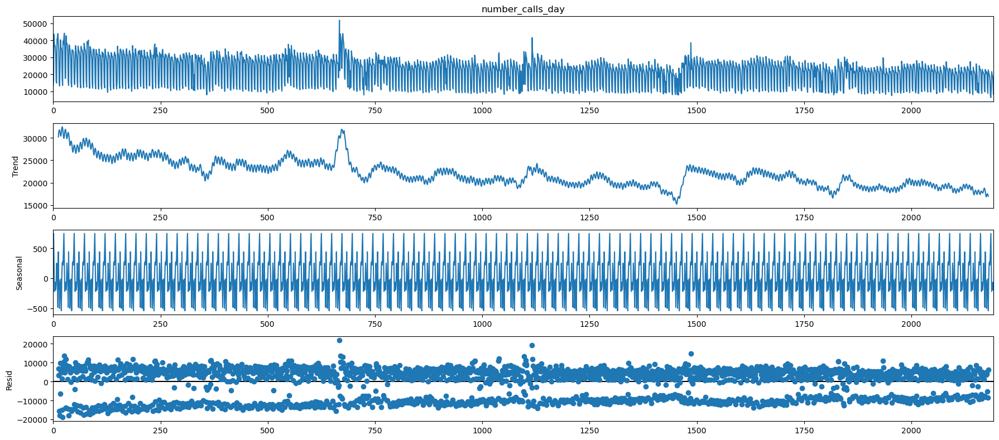

In [9]:
data['DATE_TIME'] = pd.to_datetime(data['DATE_TIME'])
rcParams['figure.figsize'] = 18, 8
decomposition = seasonal_decompose(data['number_calls_day'], model='additive', period=24)
fig = decomposition.plot()
plt.show()


# ADFULLER - Augmented Dickey Fuller Test (ADF Test)

Augmented Dickey Fuller test (ADF Test) is a common statistical test used to test whether a given Time series is stationary or not. It is one of the most commonly used statistical test when it comes to analyzing the stationary of a series.

In [10]:
result = adfuller(data['number_calls_day'], autolag="AIC")

print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Lags Used: %f' % result[2])
print('Number of Observations: %f' % result[3])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))


ADF Statistic: -4.086871
p-value: 0.001018
Lags Used: 26.000000
Number of Observations: 2165.000000
Critical Values:
	1%: -3.433
	5%: -2.863
	10%: -2.567


In [11]:
result

(-4.086871292317081,
 0.001018067806779035,
 26,
 2165,
 {'1%': -3.4333740509447717,
  '5%': -2.8628759187993382,
  '10%': -2.567481176655697},
 40774.791607421226)

In [12]:
def adf_test(timeseries):
    print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
        dftest[0:4],
        index=[
            "Test Statistic",
            "p-value",
            "#Lags Used",
            "Number of Observations Used",
        ],
    )
    for key, value in dftest[4].items():
        dfoutput["Critical Value (%s)" % key] = value
    print(dfoutput)

In [13]:
adf_test(data['number_calls_day'])

Results of Dickey-Fuller Test:
Test Statistic                   -4.086871
p-value                           0.001018
#Lags Used                       26.000000
Number of Observations Used    2165.000000
Critical Value (1%)              -3.433374
Critical Value (5%)              -2.862876
Critical Value (10%)             -2.567481
dtype: float64


The ADF statistic is -34.652979, which is a large negative value. This indicates that there is strong evidence against the null hypothesis of a unit root (non-stationarity) in the data.
The p-value is 0.0, which is < significance level of 0.05. This means that we can reject the null hypothesis and conclude that the data is stationary.
The number of lags used in the test is 58, and the number of observations is 52549.
The critical values at the 1%, 5%, and 10% levels are -3.430, -2.862, and -2.567, respectively. 
Since the ADF statistic is more negative than these critical values, we can reject the null hypothesis at any of these levels.
Finally, the last value, icbest, is the maximized information criterion of the regression. This value is used to select the optimal number of lags in the regression model. In this case, the optimal number of lags is likely around 58.

Therefore, **this time series IS STATIONARY according to this test.**

In [14]:
def kpss_test(timeseries):
    print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags = "auto") # In later versions, the "lags" option has been replaced by "nlags"
    kpss_output = pd.Series(
        kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    print(kpss_output)

In [15]:
display(kpss_test(data['number_calls_day']))

Results of KPSS Test:
Test Statistic            2.801055
p-value                   0.010000
Lags Used                59.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64


/Users/estelaoshiro/opt/anaconda3/envs/finalproject/lib/python3.9/site-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




None

The test statistic is 14.738202 and the p-value is 0.01, which is smaller than the 5% significance level. This suggests that the null hypothesis of stationarity is rejected and the **time series is not stationary.**

**Test results are not consistent**

From statsmodel
Case 4: KPSS indicates non-stationarity and ADF indicates stationarity - The series is difference stationary. Differencing is to be used to make series stationary. The differenced series is checked for stationarity.
Here, due to the difference in the results from ADF test and KPSS test, it can be inferred that the series is trend stationary and not strict stationary. The series can be detrended by differencing or by model fitting.

Detrending by Differencing¶
It is one of the simplest methods for detrending a time series. A new series is constructed where the value at the current time step is calculated as the difference between the original observation and the observation at the previous time step.

In [ ]:
# Take the first difference of the series
diff_series = data['number_calls_hour'].diff().dropna()

adf_test(diff_series)

In [ ]:
kpss_test(diff_series)

/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




According to this test, the p-values is 0.10 > 0.05. On the other hand, the test statistic is 0.0098 which is smaller than the critical value corresponding to a significance level of 5% = 0.46. Therefore, according to this test we accept the null hypothesis H0 which is: TS is stationary.


# Decomposing the TS

In [ ]:
diff_series

1       -12.0
2       -30.0
3       -28.0
4        65.0
5       -28.0
         ... 
52603   -27.0
52604   -46.0
52605   -95.0
52606    -9.0
52607    11.0
Name: number_calls_hour, Length: 52607, dtype: float64

In [ ]:
new_data = pd.DataFrame
new_data = data['DATE_TIME']
new_data = pd.concat([new_data, diff_series], axis=1)
new_data

,DATE_TIME,number_calls_hour
0,2011-01-01 00:00:00,NaN
1,2011-01-01 01:00:00,-12.0
2,2011-01-01 02:00:00,-30.0
3,2011-01-01 03:00:00,-28.0
4,2011-01-01 04:00:00,65.0
...,...,...
52603,2016-12-31 19:00:00,-27.0
52604,2016-12-31 20:00:00,-46.0
52605,2016-12-31 21:00:00,-95.0
52606,2016-12-31 22:00:00,-9.0


In [ ]:
new_data['number_calls_hour'].isna().sum()

1

In [ ]:
new_data['number_calls_hour']=new_data['number_calls_hour'].fillna(data['number_calls_hour'][0])
new_data

,DATE_TIME,number_calls_hour
0,2011-01-01 00:00:00,123.0
1,2011-01-01 01:00:00,-12.0
2,2011-01-01 02:00:00,-30.0
3,2011-01-01 03:00:00,-28.0
4,2011-01-01 04:00:00,65.0
...,...,...
52603,2016-12-31 19:00:00,-27.0
52604,2016-12-31 20:00:00,-46.0
52605,2016-12-31 21:00:00,-95.0
52606,2016-12-31 22:00:00,-9.0


In [ ]:
new_data.dtypes

DATE_TIME            datetime64[ns]
number_calls_hour           float64
dtype: object

In [ ]:
new_data['DATE_TIME'] = pd.to_datetime(new_data['DATE_TIME'])

In [ ]:
new_data.dtypes

DATE_TIME            datetime64[ns]
number_calls_hour           float64
dtype: object

In [ ]:
new_data.set_index('DATE_TIME', inplace=True)

In [ ]:
# seasonal decomposition
result = seasonal_decompose(new_data['number_calls_hour'], model='additive')

In [ ]:
print(result.trend) # By default the previous function uses a "rolling mean" with a window of three values
print(result.seasonal) # Seasonal component
print(result.resid) # Remainder
print(result.observed) # Original TS.

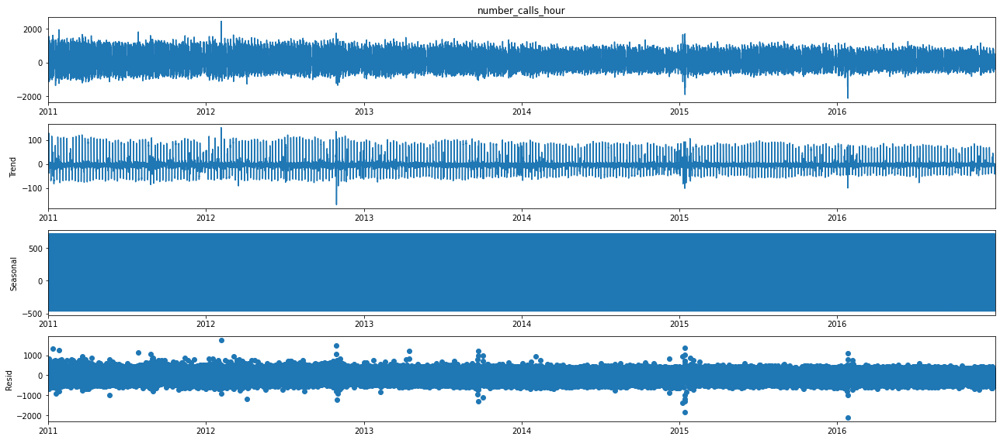

In [ ]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(new_data['number_calls_hour'], model='additive')
fig = decomposition.plot()
plt.show()

# ACF and PACF

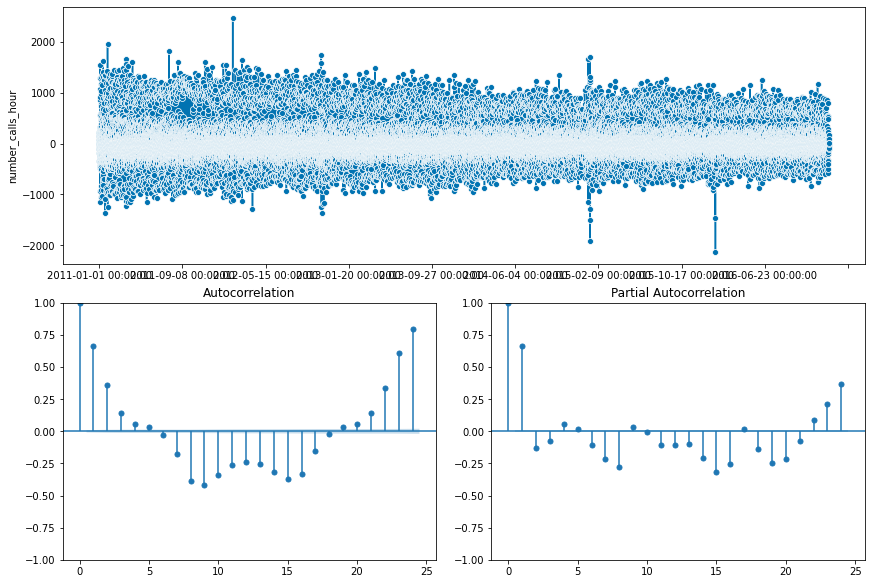

In [ ]:
plot_correlations(new_data['number_calls_hour']);

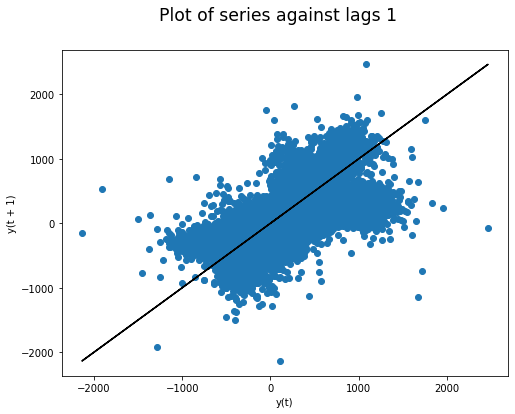

In [ ]:
fig, ax = plot_lags(new_data['number_calls_hour'])
plt.plot(new_data['number_calls_hour'],new_data['number_calls_hour'],color="black")
plt.show()

# Train-test split

In [ ]:
y_train, y_test = temporal_train_test_split(new_data['number_calls_hour'], train_size=0.8) 

display(y_train.head())
display(y_test.head())

2011-01-01 00:00:00    123.0
2011-01-01 01:00:00    -12.0
2011-01-01 02:00:00    -30.0
2011-01-01 03:00:00    -28.0
2011-01-01 04:00:00     65.0
Name: number_calls_hour, dtype: float64

2015-10-20 14:00:00    -22.0
2015-10-20 15:00:00    -21.0
2015-10-20 16:00:00   -270.0
2015-10-20 17:00:00   -569.0
2015-10-20 18:00:00   -481.0
Name: number_calls_hour, dtype: float64

In [ ]:
len(y_train)
#len(y_test)

42086

# Forecasting 

In [ ]:
fh_train = fh = ForecastingHorizon(y_train.index, freq="H", is_relative=False)

print(fh_train)

In [ ]:
fh_test = ForecastingHorizon(y_test.index, freq="H", is_relative=False)

print(fh_test)

# Facebook Prophet

In [ ]:
forecaster_prophet_25 = Prophet(seasonality_mode='additive',n_changepoints=25)

forecaster_prophet_25.fit(y_train)  
forecaster_prophet_25.get_params()

{'add_country_holidays': None,
 'add_seasonality': None,
 'alpha': 0.05,
 'changepoint_prior_scale': 0.05,
 'changepoint_range': 0.8,
 'changepoints': None,
 'daily_seasonality': 'auto',
 'freq': None,
 'growth': 'linear',
 'growth_cap': None,
 'growth_floor': 0.0,
 'holidays': None,
 'holidays_prior_scale': 10.0,
 'mcmc_samples': 0,
 'n_changepoints': 25,
 'seasonality_mode': 'additive',
 'seasonality_prior_scale': 10.0,
 'stan_backend': None,
 'uncertainty_samples': 1000,
 'verbose': 0,
 'weekly_seasonality': 'auto',
 'yearly_seasonality': 'auto'}

In [ ]:
results = pd.DataFrame({"Set":["Train"]*len(y_train)+["Test"]*len(y_test),
                        "number_calls_hour":new_data['number_calls_hour']})

In [ ]:
results['naive'] = np.abs(results["number_calls_hour"]-results["number_calls_hour"].shift())
quotient_train = results[results['Set']=="Train"]['naive'].mean()
quotient_test = results[results['Set']=="Test"]['naive'].mean()


In [ ]:

results.loc[results["Set"]=="Train","Prophet_Predicted_25"] = forecaster_prophet_25.predict(fh_train).values
results.loc[results["Set"]=="Test","Prophet_Predicted_25"]  = forecaster_prophet_25.predict(fh_test).values
results["Prophet_Residuals_25"] = results["number_calls_hour"] - results["Prophet_Predicted_25"]
results.loc[results["Set"]=="Train","Prophet_q_25"] = np.abs(results.loc[results["Set"]=="Train","Prophet_Residuals_25"])/quotient_train
results.loc[results["Set"]=="Test","Prophet_q_25"]  = np.abs(results.loc[results["Set"]=="Test","Prophet_Residuals_25"])/quotient_test

results = results.reset_index().rename(columns={"index":"Date"})

In [ ]:
mase = MeanAbsoluteScaledError()
mase(y_train, results.loc[results["Set"]=="Train","Prophet_Predicted_25"], y_train=y_train)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.730915202020053

In [ ]:
mase(y_test, results.loc[results["Set"]=="Test","Prophet_Predicted_25"], y_train=y_test)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.8003636492645014

In [ ]:
fig = px.line(data_frame=results, x='Date', y='number_calls_hour', color='Set',
              title='Actual vs Predicted Number of Calls', labels={'number_calls_hour': 'Number of Calls'})
fig.add_scatter(x=results[results['Set']=='Train']['Date'], y=results[results['Set']=='Train']['Prophet_Predicted_25'], 
                mode='lines', name='Prophet Train Predictions')
fig.add_scatter(x=results[results['Set']=='Test']['Date'], y=results[results['Set']=='Test']['Prophet_Predicted_25'], 
                mode='lines', name='Prophet Test Predictions')
fig.show()

Facebook Prophet n_changepoints = 50

In [ ]:
forecaster_prophet_50 = Prophet(seasonality_mode='additive',n_changepoints=50)

forecaster_prophet_50.fit(y_train)  
forecaster_prophet_50.get_params()

{'add_country_holidays': None,
 'add_seasonality': None,
 'alpha': 0.05,
 'changepoint_prior_scale': 0.05,
 'changepoint_range': 0.8,
 'changepoints': None,
 'daily_seasonality': 'auto',
 'freq': None,
 'growth': 'linear',
 'growth_cap': None,
 'growth_floor': 0.0,
 'holidays': None,
 'holidays_prior_scale': 10.0,
 'mcmc_samples': 0,
 'n_changepoints': 50,
 'seasonality_mode': 'additive',
 'seasonality_prior_scale': 10.0,
 'stan_backend': None,
 'uncertainty_samples': 1000,
 'verbose': 0,
 'weekly_seasonality': 'auto',
 'yearly_seasonality': 'auto'}

In [ ]:
results2 = pd.DataFrame({"Set":["Train"]*len(y_train)+["Test"]*len(y_test),
                        "number_calls_hour":new_data['number_calls_hour']})

In [ ]:
results2['naive'] = np.abs(results2["number_calls_hour"]-results2["number_calls_hour"].shift())
quotient_train = results2[results2['Set']=="Train"]['naive'].mean()
quotient_test = results2[results2['Set']=="Test"]['naive'].mean()


In [ ]:
results2.loc[results2["Set"]=="Train","Prophet_Predicted_50"] = forecaster_prophet_50.predict(fh_train).values
results2.loc[results2["Set"]=="Test","Prophet_Predicted_50"]  = forecaster_prophet_50.predict(fh_test).values
results2["Prophet_Residuals_50"] = results2["number_calls_hour"] - results2["Prophet_Predicted_50"]
results2.loc[results2["Set"]=="Train","Prophet_q_50"] = np.abs(results2.loc[results2["Set"]=="Train","Prophet_Residuals_50"])/quotient_train
results2.loc[results2["Set"]=="Test","Prophet_q_50"]  = np.abs(results2.loc[results2["Set"]=="Test","Prophet_Residuals_50"])/quotient_test

results2 = results2.reset_index().rename(columns={"index":"Date"})

In [ ]:
mase = MeanAbsoluteScaledError()
mase(y_train, results2.loc[results2["Set"]=="Train","Prophet_Predicted_50"], y_train=y_train)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.7309244979672115

In [ ]:
mase(y_test, results2.loc[results2["Set"]=="Test","Prophet_Predicted_50"], y_train=y_test)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.800369277775991

In [ ]:
fig = px.line(data_frame=results2, x='Date', y='number_calls_hour', color='Set',
              title='Actual vs Predicted Number of Calls', labels={'number_calls_hour': 'Number of Calls'})
fig.add_scatter(x=results2[results2['Set']=='Train']['Date'], y=results2[results2['Set']=='Train']['Prophet_Predicted_50'], 
                mode='lines', name='Prophet Train Predictions')
fig.add_scatter(x=results2[results2['Set']=='Test']['Date'], y=results2[results2['Set']=='Test']['Prophet_Predicted_50'], 
                mode='lines', name='Prophet Test Predictions')
fig.show()

Facebook Prophet n_changepoints = 50, add seasonality

In [ ]:
forecaster_prophet_50 = Prophet(seasonality_mode='additive',
                     n_changepoints=30,
                     weekly_seasonality=True,
                     daily_seasonality=True)
                     
forecaster_prophet_50.fit(y_train)

Prophet(daily_seasonality=True, n_changepoints=30, weekly_seasonality=True)

In [ ]:
forecaster_prophet_50.get_params()

{'add_country_holidays': None,
 'add_seasonality': None,
 'alpha': 0.05,
 'changepoint_prior_scale': 0.05,
 'changepoint_range': 0.8,
 'changepoints': None,
 'daily_seasonality': True,
 'freq': None,
 'growth': 'linear',
 'growth_cap': None,
 'growth_floor': 0.0,
 'holidays': None,
 'holidays_prior_scale': 10.0,
 'mcmc_samples': 0,
 'n_changepoints': 30,
 'seasonality_mode': 'additive',
 'seasonality_prior_scale': 10.0,
 'stan_backend': None,
 'uncertainty_samples': 1000,
 'verbose': 0,
 'weekly_seasonality': True,
 'yearly_seasonality': 'auto'}

In [ ]:
results3 = pd.DataFrame({"Set":["Train"]*len(y_train)+["Test"]*len(y_test),
                        "number_calls_hour":new_data['number_calls_hour']})

In [ ]:
results3.loc[results3["Set"]=="Train","Prophet_Predicted_50"] = forecaster_prophet_50.predict(fh_train).values
results3.loc[results3["Set"]=="Test","Prophet_Predicted_50"]  = forecaster_prophet_50.predict(fh_test).values

In [ ]:
results3["Prophet_Residuals"] = results3["number_calls_hour"] - results3["Prophet_Predicted_50"]
results3.loc[results3["Set"]=="Train","Prophet_q"] = np.abs(results3.loc[results3["Set"]=="Train","Prophet_Residuals"])/quotient_train
results3.loc[results3["Set"]=="Test","Prophet_q"]  = np.abs(results3.loc[results3["Set"]=="Test","Prophet_Residuals"])/quotient_test
results3.head()

,Set,number_calls_hour,Prophet_Predicted_50,Prophet_Residuals,Prophet_q
2011-01-01 00:00:00,Train,123.0,-177.887004,300.887004,1.913263
2011-01-01 01:00:00,Train,-12.0,-85.439376,73.439376,0.466982
2011-01-01 02:00:00,Train,-30.0,-5.628737,-24.371263,0.154971
2011-01-01 03:00:00,Train,-28.0,-15.476900,-12.523100,0.079631
2011-01-01 04:00:00,Train,65.0,-77.338545,142.338545,0.905094


In [ ]:
results3 = results3.reset_index().rename(columns={"index":"Date"})

In [ ]:
mase = MeanAbsoluteScaledError()
mase(y_train, results3.loc[results3["Set"]=="Train","Prophet_Predicted_50"], y_train=y_train)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.7309171008928524

In [ ]:
mase(y_test, results3.loc[results3["Set"]=="Test","Prophet_Predicted_50"], y_train=y_test)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.8003406962163484

In [ ]:
fig = px.line(data_frame=results3, x='Date', y='number_calls_hour', color='Set',
              title='Actual vs Predicted Number of Calls', labels={'number_calls_hour': 'Number of Calls'})
fig.add_scatter(x=results3[results3['Set']=='Train']['Date'], y=results3[results3['Set']=='Train']['Prophet_Predicted_50'], 
                mode='lines', name='Prophet Train Predictions')
fig.add_scatter(x=results3[results3['Set']=='Test']['Date'], y=results3[results3['Set']=='Test']['Prophet_Predicted_50'], 
                mode='lines', name='Prophet Test Predictions')
fig.show()

Facebook Prophet n_changepoints = 50, add just week seasonality

In [ ]:
forecaster_prophet_50 = Prophet(seasonality_mode='additive',
                     n_changepoints=50,
                     weekly_seasonality=True,
                     daily_seasonality=9,
                     changepoint_prior_scale=0.01,
                     seasonality_prior_scale=30
)



forecaster_prophet_50.fit(y_train)



Prophet(changepoint_prior_scale=0.01, daily_seasonality=9, n_changepoints=50,
        seasonality_prior_scale=30, weekly_seasonality=True)

In [ ]:
results4 = pd.DataFrame({"Set":["Train"]*len(y_train)+["Test"]*len(y_test),
                        "number_calls_hour":new_data['number_calls_hour']})

In [ ]:
results4.loc[results4["Set"]=="Train","Prophet_Predicted_50"] = forecaster_prophet_50.predict(fh_train).values
results4.loc[results4["Set"]=="Test","Prophet_Predicted_50"]  = forecaster_prophet_50.predict(fh_test).values

In [ ]:
results4["Prophet_Residuals"] = results4["number_calls_hour"] - results4["Prophet_Predicted_50"]
results4.loc[results4["Set"]=="Train","Prophet_q"] = np.abs(results4.loc[results4["Set"]=="Train","Prophet_Residuals"])/quotient_train
results4.loc[results4["Set"]=="Test","Prophet_q"]  = np.abs(results4.loc[results4["Set"]=="Test","Prophet_Residuals"])/quotient_test
results4.head()

,Set,number_calls_hour,Prophet_Predicted_50,Prophet_Residuals,Prophet_q
2011-01-01 00:00:00,Train,123.0,-153.499289,276.499289,1.758188
2011-01-01 01:00:00,Train,-12.0,-77.095379,65.095379,0.413925
2011-01-01 02:00:00,Train,-30.0,-61.398297,31.398297,0.199654
2011-01-01 03:00:00,Train,-28.0,-47.149473,19.149473,0.121767
2011-01-01 04:00:00,Train,65.0,-29.202693,94.202693,0.599011


In [ ]:
results4 = results4.reset_index().rename(columns={"index":"Date"})

In [ ]:
mase = MeanAbsoluteScaledError()
mase(y_train, results4.loc[results3["Set"]=="Train","Prophet_Predicted_50"], y_train=y_train)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.6439484620526131

In [ ]:
mase(y_test, results4.loc[results4["Set"]=="Test","Prophet_Predicted_50"], y_train=y_test)

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:411: UserWarning:

y_pred and y_true do not have the same row index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.

/usr/local/lib/python3.8/dist-packages/sktime/performance_metrics/forecasting/_classes.py:422: UserWarning:

y_pred and y_true do not have the same column index. This may indicate incorrect objects passed to the metric. Indices of y_true will be used for y_pred.



0.668036955473649

In [ ]:
fig = px.line(data_frame=results4, x='Date', y='number_calls_hour', color='Set',
              title='Actual vs Predicted Number of Calls', labels={'number_calls_hour': 'Number of Calls'})
fig.add_scatter(x=results4[results4['Set']=='Train']['Date'], y=results4[results4['Set']=='Train']['Prophet_Predicted_50'], 
                mode='lines', name='Prophet Train Predictions')
fig.add_scatter(x=results4[results4['Set']=='Test']['Date'], y=results4[results4['Set']=='Test']['Prophet_Predicted_50'], 
                mode='lines', name='Prophet Test Predictions')
fig.show()

In [ ]:
cumsum_diff = np.cumsum(diff_series)
cumsum_diff

1        -12.0
2        -42.0
3        -70.0
4         -5.0
5        -33.0
         ...  
52603    243.0
52604    197.0
52605    102.0
52606     93.0
52607    104.0
Name: number_calls_hour, Length: 52607, dtype: float64

In [ ]:
cumsum_diff = np.cumsum(diff_series)

# Transform test set predictions
test_last_observed_value = results4.loc[results4["Set"]=="Test", "number_calls_hour"].iloc[-1]
y_pred_original_test = results4.loc[results4["Set"]=="Test","Prophet_Predicted_50"] + test_last_observed_value + cumsum_diff[len(y_train):]

# Transform training set predictions
train_last_observed_value = results4.loc[results4["Set"]=="Train", "number_calls_hour"].iloc[-1]
y_pred_original_train = results4.loc[results4["Set"]=="Train","Prophet_Predicted_50"] + train_last_observed_value + cumsum_diff[:len(y_train)]


In [ ]:
test_last_observed_value

11.0

In [ ]:
train_last_observed_value

-197.0

In [ ]:
cumsum_diff[:len(y_train)]

1         -12.0
2         -42.0
3         -70.0
4          -5.0
5         -33.0
          ...  
42082    2190.0
42083    2238.0
42084    2171.0
42085    1974.0
42086    1952.0
Name: number_calls_hour, Length: 42086, dtype: float64

In [ ]:
y_pred_original_test

42086            NaN
42087    1932.781091
42088    1398.091289
42089     671.438278
42090     358.181905
            ...     
52603     122.180572
52604      68.270868
52605       7.103633
52606      23.979806
52607     -37.889831
Length: 10522, dtype: float64

In [ ]:
y_pred_original_train



0                NaN
1        -286.095379
2        -300.398297
3        -314.149473
4        -231.202693
            ...     
42082    2270.099372
42083    2010.401129
42084    1898.887097
42085    1660.220191
42086            NaN
Length: 42087, dtype: float64

In [ ]:
results4.loc[results4["Set"]=="Test","Prophet_Predicted_50"]

42086    -36.484026
42087     -9.218909
42088   -273.908711
42089   -431.561722
42090   -263.818095
            ...    
52603   -131.819428
52604   -139.729132
52605   -105.896367
52606    -80.020194
52607   -152.889831
Name: Prophet_Predicted_50, Length: 10522, dtype: float64

In [ ]:

fig = px.line(data_frame=data, x='DATE_TIME', y='number_calls_hour', color='Set',
              title='Actual vs Predicted Number of Calls', labels={'number_calls_hour': 'Number of Calls'})
fig.add_scatter(x=results4[results4['Set']=='Train']['Date'], y=y_pred_original_train, 
                mode='lines', name='Prophet Train Predictions')
fig.add_scatter(x=results4[results4['Set']=='Test']['Date'], y=y_pred_original_test, 
                mode='lines', name='Prophet Test Predictions')
fig.show()